In [1]:
using Pkg
Pkg.activate(@__DIR__)
Pkg.instantiate()
using Revise, Distributions, GLMakie, Dates, DataFrames, CSV, BenchmarkTools, DataFramesMeta, LinearAlgebra, FFTW
using TrypColonies
import Serialization as s
Makie.inline!(true)  

  Activating project at `c:\Users\Andreas\Dropbox\phd\TrypColonies\TrypColonies`


true

### Choose local or static external data

In [1]:
data_path = find_data_path(local_data = false)

LoadError: UndefVarError: `find_data_path` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [ ]:
data_base = s.deserialize("data_base\\df.jls") 
data_base = @subset(data_base, :location .== data_path)   
@transform!(data_base, :doubling_time = 1 ./log2.(1 .+:growth_rate) ./3600)


Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64,Float64?
1,15,4,250000,Normal,1.5,growth_rate,1800,"(0.03, 0.03)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\Bigger_time_Default_para_250000_time_seed_6584,3,1.74655e9,298.69,C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\,Bigger_time_Default_para,"(2000, 2000)",-1.17666e-5,7.0e-11,1.0e-5,1.02818,0.2,6.66667,1,2.13937e-5,0.003,2,Normal,16,2025-05-06T15:54:44.646,5.0e-6,0.001,8000,88000.0,9.0,0.1


### Chose the Data Sets based on some conditions 

In [4]:
data_base

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64,Float64?
1,15,4,250000,Normal,1.5,growth_rate,1800,"(0.03, 0.03)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\Bigger_time_Default_para_250000_time_seed_6584,3,1.74655e9,298.69,C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\,Bigger_time_Default_para,"(2000, 2000)",-1.17666e-5,7.0e-11,1.0e-5,1.02818,0.2,6.66667,1,2.13937e-5,0.003,2,Normal,16,2025-05-06T15:54:44.646,5.0e-6,0.001,8000,88000.0,9.0,0.1


In [5]:
sort!(data_base, :unix_date)

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64,Float64?
1,15,4,250000,Normal,1.5,growth_rate,1800,"(0.03, 0.03)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\Bigger_time_Default_para_250000_time_seed_6584,3,1.74655e9,298.69,C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\,Bigger_time_Default_para,"(2000, 2000)",-1.17666e-5,7.0e-11,1.0e-5,1.02818,0.2,6.66667,1,2.13937e-5,0.003,2,Normal,16,2025-05-06T15:54:44.646,5.0e-6,0.001,8000,88000.0,9.0,0.1


In [6]:
data_used = DataFrame(data_base[end,:])

Row,radius_tanget,scale_fac,agent_number,noise_dis,velo_var_relative,sweep_parameter,sampling_interval,L,path,walker_step_size,unix_date,run_time,location,name,N,parameter_increment,Diff_coe,adsorption_rate,storage,noise_strength,grid_recover_rate,iterations,growth_rate,Diameter_colony,parameter_steps,velocity_dis,radius_collision,date,walker_speed_phy,decay_rate,grid_strength,total_time,doubling_time,Δt_walker_min
,Int64,Int64,Int64,UnionAll,Float64,String,Int64,Tuple…,String,Int64,Float64,Float64,String,String,Tuple…,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64?,Float64,Int64,UnionAll,Int64,DateTime,Float64,Float64,Int64,Float64,Float64,Float64?
1,15,4,250000,Normal,1.5,growth_rate,1800,"(0.03, 0.03)",C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\Bigger_time_Default_para_250000_time_seed_6584,3,1.74655e9,298.69,C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\,Bigger_time_Default_para,"(2000, 2000)",-1.17666e-5,7.0e-11,1.0e-5,1.02818,0.2,6.66667,1,2.13937e-5,0.003,2,Normal,16,2025-05-06T15:54:44.646,5.0e-6,0.001,8000,88000.0,9.0,0.1


### Chose analysis function of agents

An analysis function has to directly work on the .jls files and return a object per .jls file that can be plotted afterwards.  

In [7]:
path_vec = create_data_path_vector(data_used.path);

## One iteration 

In [8]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_points = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_points)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

growth_rate
total_time: 88000.0[s]   sampling_interval: 1800[s]    time_points: 49
Para_Steps:2
Iterations:1


In [9]:
update_theme!(Theme(fontsize = 20))

In [10]:
para_range = 1:1:p_s
doubling_time = string.(round.([1 ./log2.(1 .+data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1]) ./3600 for p in para_range], digits = 4)  )


2-element Vector{String}:
 "9.0"
 "20.0"

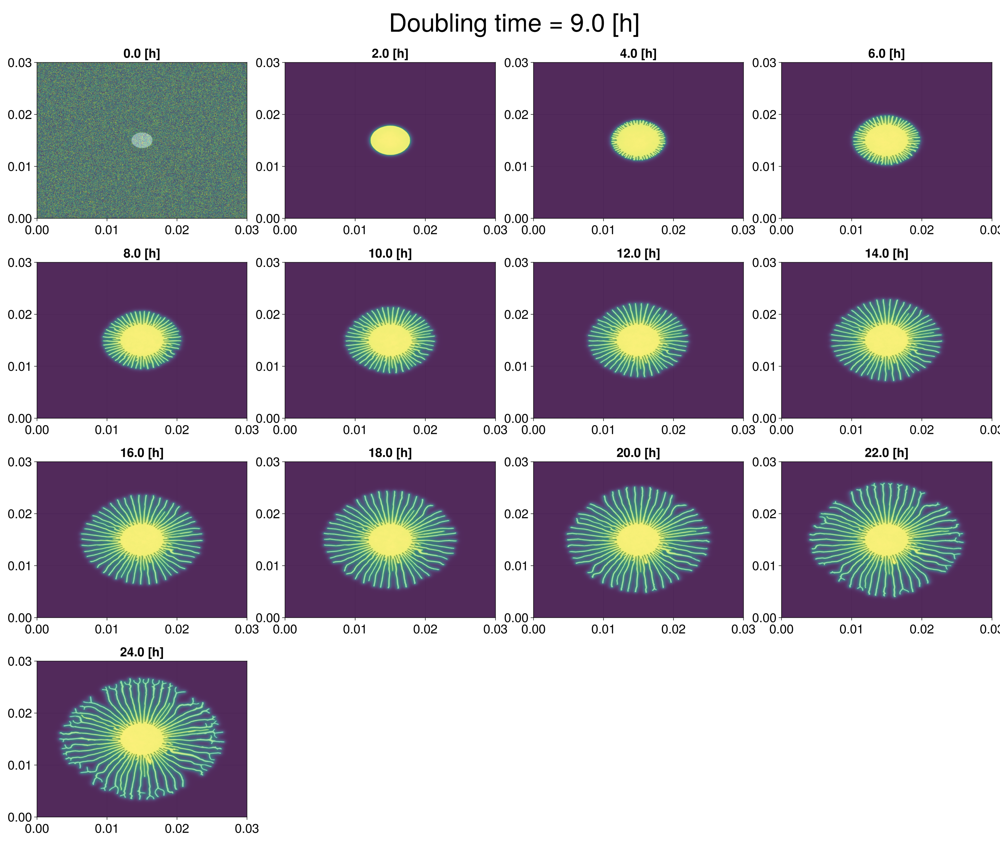

In [29]:
it = 1 * data_used.iterations[1] 
data = s.deserialize(path_vec[1][it])
range = 1:4:length(data[1])
plt_n = 1
update_theme!(Theme(fontsize = 25))

size = size = res_scaling(length(range), factor = 2.0 , plots = plt_n,plots_per_row = 4) 

fig = Figure(size  = size)

c = 0
for i in range 
    ax = Axis(fig[c÷4+1,(c%4+1)],title = "$(round(data_used.sampling_interval[1]*(i-1)/3600,digits = 2)) [h]") 
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][i]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][i], colormap = (:viridis,0.6))
    c += 1  
end

supertitle = Label(fig[0, :], "Doubling time = $(doubling_time[it]) [h]", fontsize = 50)

#supertitle = Label(fig[0, :], "$(s_p)=$(getproperty(data[4].pa_ph,Symbol(s_p)))", fontsize = 40)

display(fig)
mkpath(data_used.path[1]*"\\analysis\\single")
save(data_used.path[1]*"\\analysis\\single\\heatmap_2h_$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p))).png", fig, px_per_unit = 2, size = size)


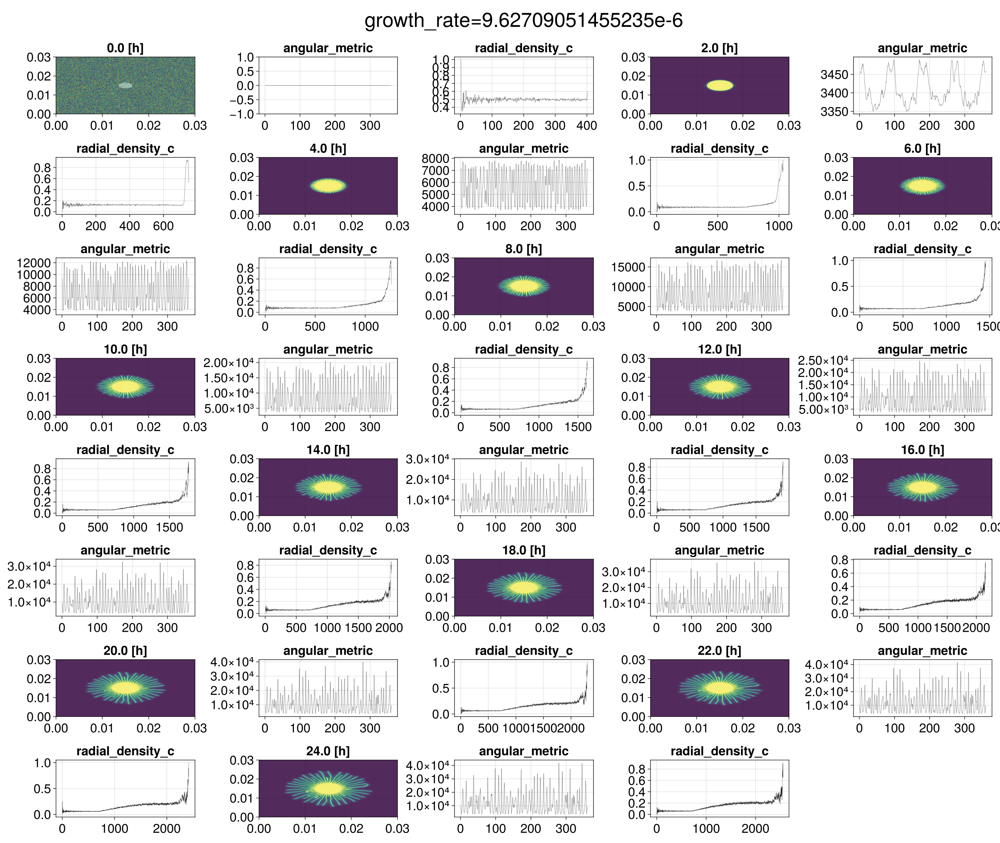

In [30]:
it = 2 * data_used.iterations[1] 
data = s.deserialize(path_vec[1][it])
datu = transform_data(data)
range = 1:4:length(data[1])
plt_n = 3
size = res_scaling(length(range), factor = 2 , plots = plt_n)
fig2 = Figure(size =size)
c = 0
for i in range 
    ax = Axis(fig2[c÷5+1,(c%5+1)], title = "$(round(data_used.sampling_interval[1]*(i-1)/3600,digits = 2)) [h]")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][i]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][i], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig2[c÷5+1,(c%5+1)], title = "angular_metric")
    lines!(ax2, angular_metric(datu[i]...), color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig2[c÷5+1,(c%5+1)], title = "radial_density_c")
    lines!(ax3, radial_density_c(datu[i]...), color = :black, linewidth = .3)
    c += 1  
end
supertitle = Label(fig2[0, :], "$(s_p)=$(getproperty(data[4].pa_ph,Symbol(s_p)))", fontsize = 40)

display(fig2)

mkpath(data_used.path[1]*"\\analysis\\single")
save(data_used.path[1]*"\\analysis\\single\\heatmap_wi_$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_angular_radial.png", fig2, size = size )

## Compare data in one sweep


In [31]:
s_p = data_used.sweep_parameter[1]
p_s = data_used.parameter_steps[1]
iter = data_used.iterations[1]
time_points = round(Int, data_used.total_time[1]/data_used.sampling_interval[1])
println(s_p)
println("total_time: ",data_used.total_time[1],"[s]", "   sampling_interval: ",data_used.sampling_interval[1],"[s]", "    time_points: ",time_points)
println("Para_Steps:",p_s)
println("Iterations:",iter)  

growth_rate
total_time: 88000.0[s]   sampling_interval: 1800[s]    time_points: 49
Para_Steps:2
Iterations:1


In [32]:
time_point = 48
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s

1:1:2

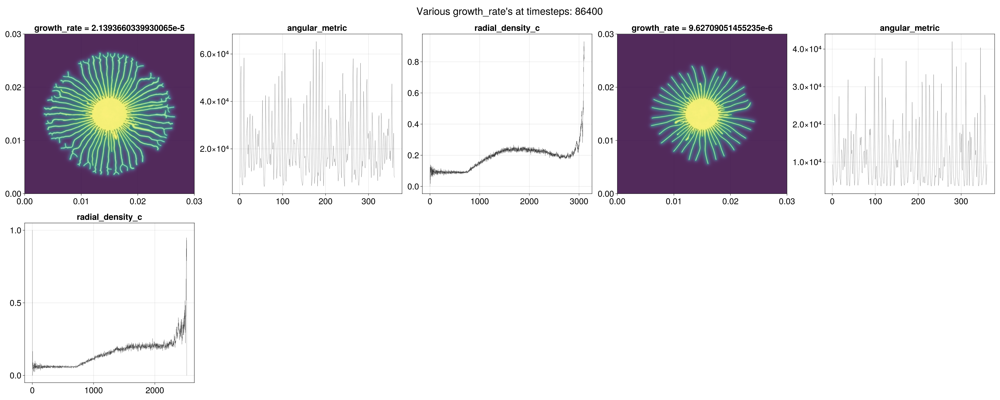

In [33]:
size  = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig3 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig3[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig3[c÷5+1,(c%5+1)], title = "angular_metric")
    lines!(ax2, angular_metric(datu[time_point]...), color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig3[c÷5+1,(c%5+1)], title = "radial_density_c")
    lines!(ax3, radial_density_c(datu[time_point]...), color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig3[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig3)

mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_angular_radial.png", fig3, size = size)

## Area gain and adsorpted material 

In [34]:
time_point = 48 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s

1:1:2

In [35]:
data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area_adsorbed.png"

"C:\\Users\\Andreas\\Desktop\\simulation_data_julia\\Bigger_time_Default_para_250000_time_seed_6584\\analysis\\growth_rate_9.62709051455235e-6_time_point_48_area_adsorbed.png"

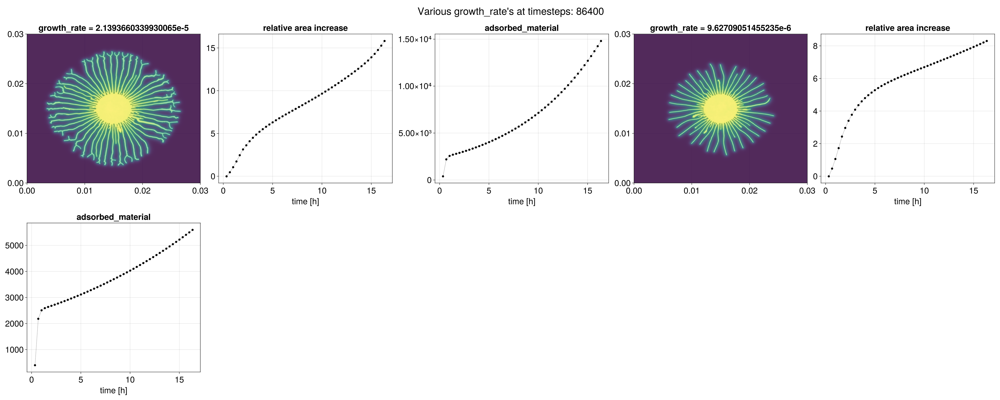

In [36]:
size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig4 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig4[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig4[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3), [area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig4[c÷5+1,(c%5+1)], title = "adsorbed_material",xlabel = "time [h]")
    scatterlines!(ax3, (1:length(datu)).*(1/3),[adsorbed_material(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig4[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig4)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area_adsorbed.png", fig4, size = size)

In [37]:
time_point = 48 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = 1:1:p_s


1:1:2

In [38]:
data = length(s.deserialize(path_vec[1][1*it_u]))

4

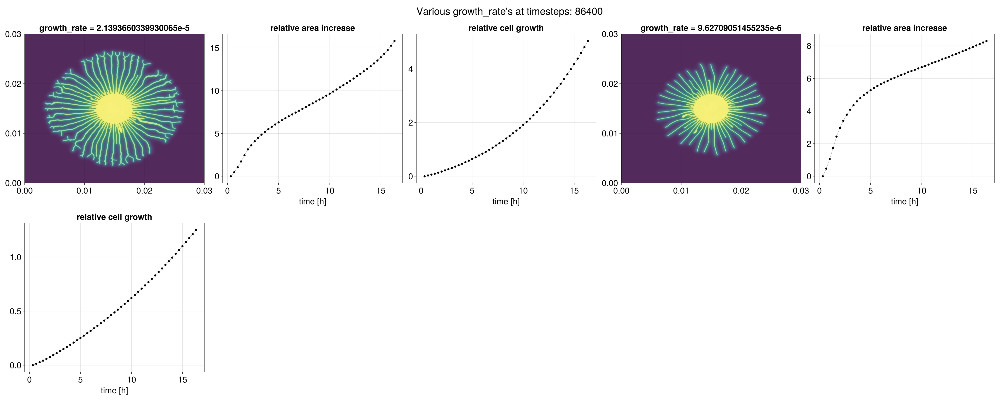

In [39]:
size = res_scaling(length(para_range), factor = 3 , plots = plt_n)
fig5 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig5[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
    ax2 = Axis(fig5[c÷5+1,(c%5+1)], title = "relative area increase", xlabel = "time [h]")
    scatterlines!(ax2,(1:length(datu)).*(1/3) ,[area_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1  
    ax3 = Axis(fig5[c÷5+1,(c%5+1)], title = "relative cell growth",xlabel = "time [h]")
    scatterlines!(ax3,(1:length(datu)).*(1/3), [cell_gain(x...) for x in datu], color = :black, linewidth = .3)
    c += 1 
end

supertitle = Label(fig5[0, :], "Various $(s_p)'s at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig5)


mkpath(data_used.path[1]*"\\analysis")
save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)

name_analysis = "comparison_corfunc_circle" 

analysis_path = "analysis\\$cor_func"*string(data_used[1,:]["agent_number"])*"$(name_analysis)\\"

mkpath(analysis_path)

save(analysis_path*"fig.pdf",fig)
analysis_data = (data_used,anaylsis_data, sweep_parameter)


s.serialize(analysis_path*"data.jls",analysis_data)

## Metrics

In [40]:
data = s.deserialize(path_vec[1][1*it_u])
datu = transform_data(data)
Og_size = og_size(datu[1]...) 
it_u = data_used.iterations[1]  
plt_n = 3
para_range = collect(1:5:p_s)
length_data = round(Int,data_used.total_time[1]/data_used.sampling_interval[1])

49

In [41]:
para_range = [1,2]

2-element Vector{Int64}:
 1
 2

In [42]:
Og_size

502625

In [68]:
angular_metric_vec = [[zeros(Int, 360) for i in 1:length_data] for j in 1:length(para_range)];
pair_metric_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];
area_gain_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
cell_gain_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
adsorbed_material_vec = [[0.0 for i in 1:length_data] for j in 1:length(para_range)];
length(angular_metric_vec);

## Create Data

In [74]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[1][x*it_u])
    datu = transform_data(data)
    pair_metric_vec[i] = [pair_cor_metric(datu[j]... ; max_samples = 10000000) for j in 1:length_data]

end

In [75]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[1][x*it_u])
    datu = transform_data(data)
    angular_metric_vec[i] = [angular_metric(datu[j]...) for j in 1:length_data]
    area_gain_vec[i] = [area_gain(datu[j]...) for j in 1:length_data]
end

In [69]:
Threads.@threads for (i,x) in collect(enumerate(para_range))
    data = s.deserialize(path_vec[1][x*it_u])
    datu = transform_data(data)
    adsorbed_material_vec[i] = [adsorbed_material(datu[j]...) for j in 1:length_data]
    cell_gain_vec[i] = ([cell_gain(datu[j]...) for j in 1:length_data].+1)*data_used.agent_number[1]
end

In [77]:
cell_gain_vec

2-element Vector{Vector{Float64}}:
 [250000.0, 257994.0, 266215.0, 274908.0, 284188.0, 294479.0, 305433.0, 316660.0, 328444.0, 340971.0  …  1.071305e6, 1.113031e6, 1.156392e6, 1.201612e6, 1.248368e6, 1.296819e6, 1.347702e6, 1.40063e6, 1.455132e6, 1.511954e6]
 [250000.0, 253498.99999999997, 256953.0, 260658.99999999997, 264636.0, 268964.0, 273380.0, 277885.0, 282559.0, 287291.0  …  482252.0, 490632.0, 499211.0, 507959.00000000006, 516763.0, 525688.0, 534916.0, 544219.0, 553648.0, 563297.0]

In [46]:
"""fourier_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];
@transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))
    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])
    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)

   """ 

"fourier_vec = [[zeros(Float64, 360) for i in 1:length_data] for j in 1:length(para_range)];\n@transform(:fourier_conv = (fft.(:metric_cov)), :fourier_OG = (fft.(:metric_OG)))\n    @transform(:abs_cov = [abs.(x[2:360÷2]) for x in :fourier_conv], :abs_OG = [abs.(x[2:360÷2]) for x in :fourier_OG])\n    @transform(:abs_cov_n = :abs_cov./:OG_size, :abs_OG_n = :abs_OG ./ :OG_size)\n\n   "

In [76]:
function fourier_ik(metric, Og_size)
    fourier = fft(metric)
    fourier = abs.(fourier[2:360÷2])
    fourier = fourier ./ Og_size
    return sum(fourier)
end

fourier_ik (generic function with 1 method)

In [78]:
hans = fourier_ik(angular_metric_vec[1][1], Og_size)

0.0

In [79]:
doubling_time = string.(round.([1 ./log2.(1 .+data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1]) ./3600 for p in para_range], digits = 4)  )


2-element Vector{String}:
 "9.0"
 "20.0"

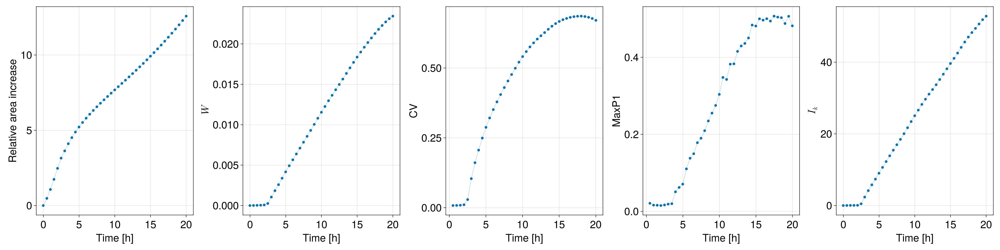

In [80]:
para_range = [1]
size = (2400, 600)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig6[1,2], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[1,3], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[1,4], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[1,5], ylabel = L"I_k", xlabel = "Time [h]")

samp_fac = data_used.sampling_interval[1] /3600
time_x = (0:40).*samp_fac
l_t = length(time_x)

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, time_x, area_gain_vec[i][1:l_t], linewidth = .3, label= doubling_time[i]) 
    scatterlines!(ax2, time_x,[roughness(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, time_x, [std(x)/mean(x) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, time_x, [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:l_t], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, time_x, [fourier_ik(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
end

"""
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)


axislegend(ax, "Doubling time", position = :lt)
axislegend(ax2, "Doubling time", position = :lt)
axislegend(ax3, "Doubling time", position = :lt)
axislegend(ax4, "Doubling time", position = :lt)
axislegend(ax5, "Doubling time", position = :lt)
"""


save(data_used.path[1]*"\\analysis\\roughness_default.png", fig6, size = size)
fig6

0.0:0.5:20.0

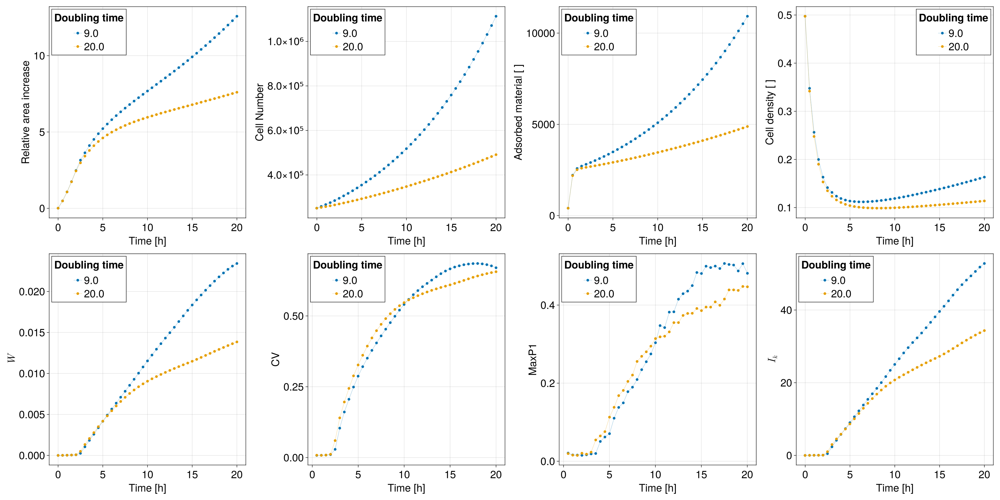

In [88]:
para_range = [1,2]
size = (2400, 1200)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax1 = Axis(fig6[1,2], ylabel = "Cell Number", xlabel = "Time [h]")
ax1_1 = Axis(fig6[1,3], ylabel = "Adsorbed material [ ]", xlabel = "Time [h]")
ax1_2 = Axis(fig6[1,4], ylabel = "Cell density [ ]", xlabel = "Time [h]")


ax2 = Axis(fig6[2,1], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[2,2], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[2,3], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[2,4], ylabel = L"I_k", xlabel = "Time [h]")

samp_fac = data_used.sampling_interval[1] /3600
time_x = (0:40).*samp_fac
l_t = length(time_x)

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, time_x, area_gain_vec[i][1:l_t], linewidth = .3, label= doubling_time[i]) 

    scatterlines!(ax1, time_x, cell_gain_vec[i][1:l_t], linewidth = .3, label= doubling_time[i])
    scatterlines!(ax1_1, time_x, adsorbed_material_vec[i][1:l_t], linewidth = .3, label= doubling_time[i])

    scatterlines!(ax1_2, time_x, cell_gain_vec[i][1:l_t]./((area_gain_vec[i][1:l_t].+1)*Og_size), linewidth = .3, label= doubling_time[i])

    scatterlines!(ax2, time_x,[roughness(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, time_x, [std(x)/mean(x) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, time_x, [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:l_t], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, time_x, [fourier_ik(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
end

"""
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)
"""

axislegend(ax, "Doubling time", position = :lt)
axislegend(ax1, "Doubling time", position = :lt)
axislegend(ax1_1, "Doubling time", position = :lt)
axislegend(ax1_2, "Doubling time", position = :rt)
axislegend(ax2, "Doubling time", position = :lt)
axislegend(ax3, "Doubling time", position = :lt)
axislegend(ax4, "Doubling time", position = :lt)
axislegend(ax5, "Doubling time", position = :lt)



save(data_used.path[1]*"\\analysis\\roughness.png", fig6, size = size)
fig6

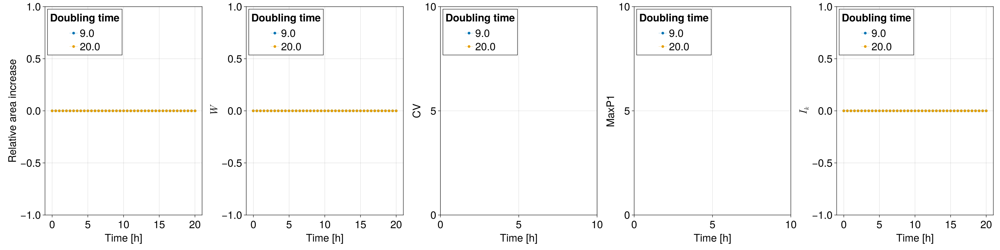

In [73]:
size = (2400, 600)
fig6 = Figure(size = size)
ax = Axis(fig6[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig6[1,2], ylabel = L"W", xlabel = "Time [h]")
ax3 = Axis(fig6[1,3], ylabel = "CV", xlabel = "Time [h]")
ax4 = Axis(fig6[1,4], ylabel = "MaxP1", xlabel = "Time [h]")
ax5 = Axis(fig6[1,5], ylabel = L"I_k", xlabel = "Time [h]")

samp_fac = data_used.sampling_interval[1] /3600
time_x = (0:40).*samp_fac
l_t = length(time_x)

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]
    # normalize by area 
    
    scatterlines!(ax, time_x, area_gain_vec[i][1:l_t], linewidth = .3, label= doubling_time[i]) 
    scatterlines!(ax2, time_x,[roughness(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, time_x, [std(x)/mean(x) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, time_x, [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:l_t], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, time_x, [fourier_ik(x,Og_size) for x in metric_single][1:l_t], linewidth = .3, label= doubling_time[i]) 
end

"""
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)
"""

axislegend(ax, "Doubling time", position = :lt)
axislegend(ax2, "Doubling time", position = :lt)
axislegend(ax3, "Doubling time", position = :lt)
axislegend(ax4, "Doubling time", position = :lt)
axislegend(ax5, "Doubling time", position = :lt)



save(data_used.path[1]*"\\analysis\\roughness.png", fig6, size = size)
fig6

In [44]:
data_used.parameter_increment[1]*(1-1)+data_used[!,s_p][1]

2.1393660339930065e-5

In [45]:
data_used[!,s_p][1]

2.1393660339930065e-5

In [46]:
area_gain_vec[1]

49-element Vector{Float64}:
  1.0
  1.476631683660781
  2.067366326784382
  2.739004227804029
  3.4690196468540164
  4.14920268589903
  4.629984580950013
  5.105056453618503
  5.510541656304402
  5.881064411837851
  6.214822183536434
  6.516468540164138
  6.801136035811987
  ⋮
 12.72085948768963
 13.003404128326286
 13.288951007212136
 13.581218602337726
 13.887454861974634
 14.209772693359861
 14.55216513305148
 14.927872668490425
 15.330803282765482
 15.781899030092017
 16.292098482964438
 16.837125093260383

In [47]:
data_used.parameter_increment[1]

-1.1766569825377715e-5

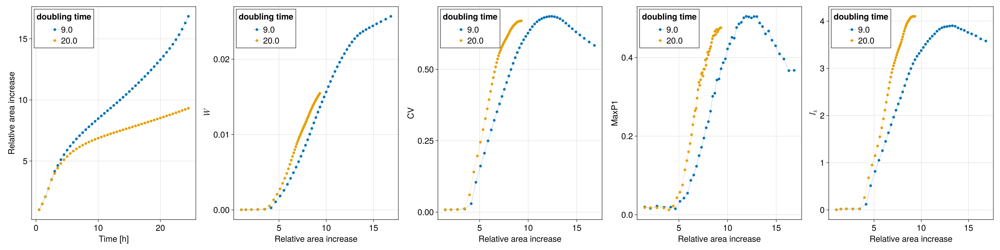

In [56]:
fig7 = Figure(size = (2400, 600))
ax = Axis(fig7[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig7[1,2], ylabel = L"W", xlabel = "Relative area increase")
ax3 = Axis(fig7[1,3], ylabel = "CV", xlabel = "Relative area increase")
ax4 = Axis(fig7[1,4], ylabel = "MaxP1", xlabel = "Relative area increase")
ax5 = Axis(fig7[1,5], ylabel = L"I_k", xlabel = "Relative area increase")

samp_fac = data_used.sampling_interval[1] /3600

for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]

    

    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*samp_fac, area_gain_vec[i], linewidth = .3, label= doubling_time[i]) 
    scatterlines!(ax2, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single], linewidth = .3, label= doubling_time[i]) 
  
    #if i < 5
        scatterlines!(ax3, area_gain_vec[i], [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= doubling_time[i]) 
        scatterlines!(ax4, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= doubling_time[i]) 
    #else
    """

        "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))"

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= doubling_time[i]) 
end

axislegend(ax, "doubling time", position = :lt)
axislegend(ax2, "doubling time", position = :lt)
axislegend(ax3, "doubling time", position = :lt)
axislegend(ax4, "doubling time", position = :lt)
axislegend(ax5, "doubling time", position = :lt)

save(data_used.path[1]*"\\analysis\\roughness_area_n.png", fig7)
fig7

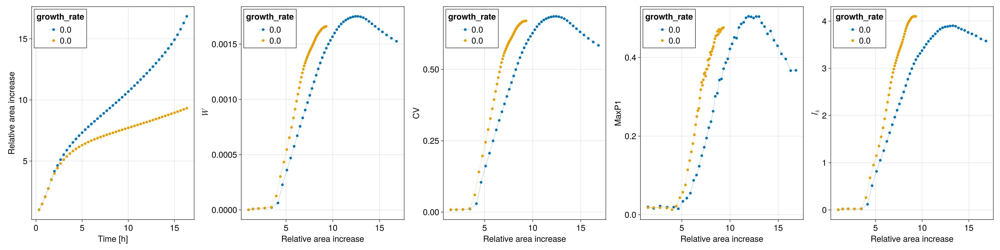

In [49]:
fig7 = Figure(size = (2400, 600))
ax = Axis(fig7[1,1], ylabel = "Relative area increase", xlabel = "Time [h]")
ax2 = Axis(fig7[1,2], ylabel = L"W", xlabel = "Relative area increase")
ax3 = Axis(fig7[1,3], ylabel = "CV", xlabel = "Relative area increase")
ax4 = Axis(fig7[1,4], ylabel = "MaxP1", xlabel = "Relative area increase")
ax5 = Axis(fig7[1,5], ylabel = L"I_k", xlabel = "Relative area increase")
for (i,p) in enumerate(para_range)
    metric_single =angular_metric_vec[i]



    
    # normalize by area 
    
    scatterlines!(ax, (1:length(datu)).*(1/3), area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))") 
    scatterlines!(ax2, area_gain_vec[i],[roughness(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
  
    #if i < 5
        scatterlines!(ax3, area_gain_vec[i], [std(x)/mean(x) for x in metric_single][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
        scatterlines!(ax4, area_gain_vec[i], [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][1:end], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
    #else
    """

        "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))"

        scatterlines!(ax3, (5:length(datu)).*(1/3), [std(x)/mean(x) for x in metric_single][5:end], linewidth = .3, label= "$(p)_CV")
        scatterlines!(ax4, (5:length(datu)).*(1/3), [(maximum(x)-mean(x))/mean(x) for x in pair_metric_vec[i]][5:end], linewidth = .3, label= "$(p)_MaxP1")
      """
    scatterlines!(ax5, area_gain_vec[i], [fourier_ik(x,Og_size) for x in metric_single]./area_gain_vec[i], linewidth = .3, label= "$(round(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1], digits =2))")
end
axislegend(ax,"$(s_p)", position = :lt)
axislegend(ax2,"$(s_p)", position = :lt)
axislegend(ax3,"$(s_p)", position = :lt)
axislegend(ax4,"$(s_p)", position = :lt)
axislegend(ax5,"$(s_p)",position = :lt)

save(data_used.path[1]*"\\analysis\\roughness_area_n.png", fig7)
fig7

In [50]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits = 2)

-0.0

In [51]:
round(data_used.parameter_increment[1]*(3-1)+data_used[!,s_p][1], digits =2)

-0.0

In [38]:
round(10.12321, digits = 2)

10.12

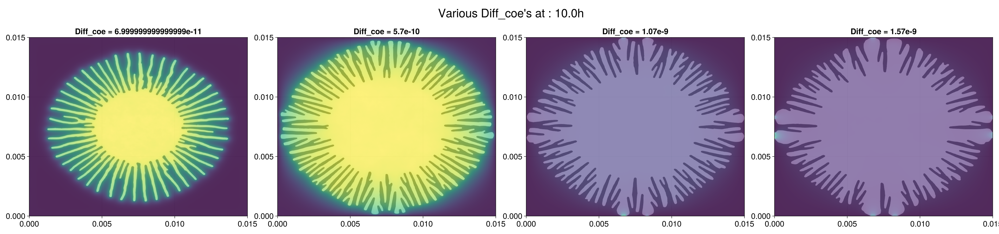

In [39]:
size = res_scaling(length(para_range), factor = 3 , plots = 1)
fig7 = Figure(size = size)
c = 0
for p in para_range
    data = s.deserialize(path_vec[1][p*it_u])
    datu = transform_data(data)
    ax = Axis(fig7[c÷5+1,(c%5+1)], title = "$(s_p) = $(data_used.parameter_increment[1]*(p-1)+data_used[!,s_p][1])")
    heatmap!(ax,data[4].xc_w,data[4].yc_w, b_w_im(data[2][time_point]), colormap = (:bone, 0.6))
    heatmap!(ax,data[4].xc_w,data[4].yc_w, data[3][time_point], colormap = (:viridis,0.6))
    c += 1
end

supertitle = Label(fig7[0, :], "Various $(s_p)'s at : $(time_point *data_used.sampling_interval[1]/3600)h", fontsize = 30)
#supertitle = Label(fig7[0, :], "Various α  at timesteps: $(time_point *data_used.sampling_interval[1])", fontsize = 30)
display(fig7)

save(data_used.path[1]*"\\analysis\\final_state.png", fig7)
#mkpath(data_used.path[1]*"\\analysis")
#save(data_used.path[1]*"\\analysis\\$(s_p)_$(getproperty(data[4].pa_ph,Symbol(s_p)))_time_point_$(time_point)_area__cells_adsorbed.png", fig5, size = size)

In [40]:
data = s.deserialize(path_vec[1][3])
datu = transform_data(data)

30-element Vector{Vector{Any}}:
 [TrypColonies.agent[TrypColonies.agent(1704, 1965, 0.6297285117322579, -0.7768152943341652), TrypColonies.agent(1927, 1743, 0.5860729834290778, -0.8102582662920138), TrypColonies.agent(2008, 1628, 0.9760266125062877, 0.21765121566281403), TrypColonies.agent(2254, 2293, 0.36925168670070957, -0.9293294312937049), TrypColonies.agent(1640, 1931, -0.25380400517361046, 0.9672556678344324), TrypColonies.agent(1757, 1684, 0.9531212796473552, 0.3025885428818946), TrypColonies.agent(1645, 2161, -0.38554307361593587, -0.922689838671033), TrypColonies.agent(2119, 2161, 0.386089841320338, 0.9224611831558205), TrypColonies.agent(2065, 1894, 0.8826116217613357, 0.47010288781481124), TrypColonies.agent(1802, 1782, -0.26460695466051964, -0.9643563446907402)  …  TrypColonies.agent(1736, 2005, -0.12031881045495438, 0.9927353040215225), TrypColonies.agent(1947, 2149, -0.6128095141150243, 0.7902306621551127), TrypColonies.agent(1929, 1620, 0.8416810881416877, 0.539974949293

In [41]:
metric

LoadError: UndefVarError: `metric` not defined in `Main`
Suggestion: check for spelling errors or missing imports.

In [ ]:
metric = [angular_metric(x...) for x in datu]

30-element Vector{Vector{Int64}}:
 [0, 0, 0, 0, 0, 0, 0, 0, 0, 0  …  0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
 [394, 416, 410, 405, 405, 405, 408, 408, 408, 402  …  414, 408, 408, 408, 404, 400, 399, 402, 401, 394]
 [960, 961, 962, 962, 963, 966, 968, 969, 970, 968  …  976, 968, 971, 970, 965, 967, 961, 962, 959, 960]
 [1592, 1606, 1601, 1600, 1605, 1607, 1610, 1611, 1612, 1611  …  1619, 1615, 1613, 1615, 1615, 1608, 1608, 1601, 1601, 1592]
 [2308, 2307, 2317, 2313, 2313, 2322, 2326, 2327, 2328, 2324  …  2337, 2337, 2338, 2331, 2326, 2326, 2315, 2315, 2317, 2308]
 [3088, 3089, 3091, 3090, 3093, 3096, 3106, 3111, 3111, 3110  …  3122, 3119, 3121, 3114, 3112, 3106, 3099, 3096, 3094, 3088]
 [3924, 3929, 3927, 3934, 3939, 3943, 3949, 3953, 3957, 3956  …  3967, 3964, 3963, 3958, 3956, 3943, 3936, 3938, 3934, 3924]
 [4807, 4811, 4824, 4826, 4831, 4838, 4843, 4852, 4856, 4858  …  4866, 4867, 4867, 4857, 4848, 4834, 4825, 4821, 4822, 4807]
 [5727, 5739, 5739, 5748, 5756, 5770, 5773, 5776, 5794, 5794  …  5

In [ ]:
length.(metric)

30-element Vector{Int64}:
 360
 360
 360
 360
 360
 360
 360
 360
 360
 360
   ⋮
 360
 360
 360
 360
 360
 360
 360
 360
 360